In [1]:
import pandas as pd

In [2]:
data=pd.read_csv("latest 20 videos data beebom.csv")

In [3]:
data.columns

Index(['Unnamed: 0', 'channel_id', 'video_id', 'title', 'url', 'description',
       'duration', 'published_at', 'thumbnails', 'view_count', 'like_count',
       'comment_count'],
      dtype='object')

Relationship between Views, Likes, and Comments - Scatter Plot

In [4]:
import plotly.io as pio
import plotly.express as px
pio.renderers.default = 'notebook'
fig = px.scatter(data, x='view_count', y='like_count', size='comment_count', color='comment_count',
                 hover_name='title', title='Relationship between Views, Likes, and Comments')
fig.show()

Video Duration Analysis - Histogram

In [5]:
import plotly.io as pio
import plotly.express as px
fig = px.histogram(data, x='duration', nbins=10, title='Distribution of Video Durations')
fig.show()

Trends based on Upload Date - Line Plot

In [6]:
import plotly.io as pio
import plotly.express as px
data['published_at'] = pd.to_datetime(data['published_at'])
data['upload_month'] = data['published_at'].dt.to_period('M').astype(str)
upload_trend = data.groupby('upload_month').size().reset_index(name='count')
fig = px.line(upload_trend, x='upload_month', y='count', title='Video Upload Trend')
fig.update_xaxes(title_text='Month')
fig.update_yaxes(title_text='Number of Videos Uploaded')
fig.show()
##Convert 'published_at' column to datetime##
data['published_at'] = pd.to_datetime(data['published_at'])
##Extract month and year from 'published_at' column##
data['month_year'] = data['published_at'].dt.to_period('M')
##Count the number of video uploads per month##
upload_per_month = data['month_year'].value_counts().sort_index()
##Most active months for video uploads##
most_active_months = upload_per_month.nlargest(3)
print("Most Active Months for Video Uploads:\n", most_active_months)

Most Active Months for Video Uploads:
 month_year
2023-05    11
2023-04     7
2023-06     2
Freq: M, Name: count, dtype: int64


Thumbnail Analysis - Image Display

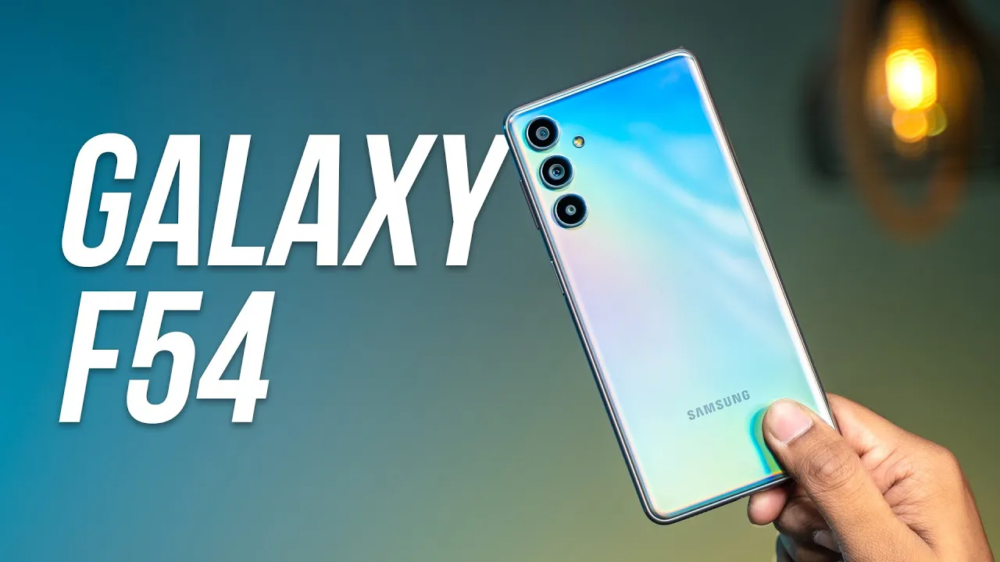

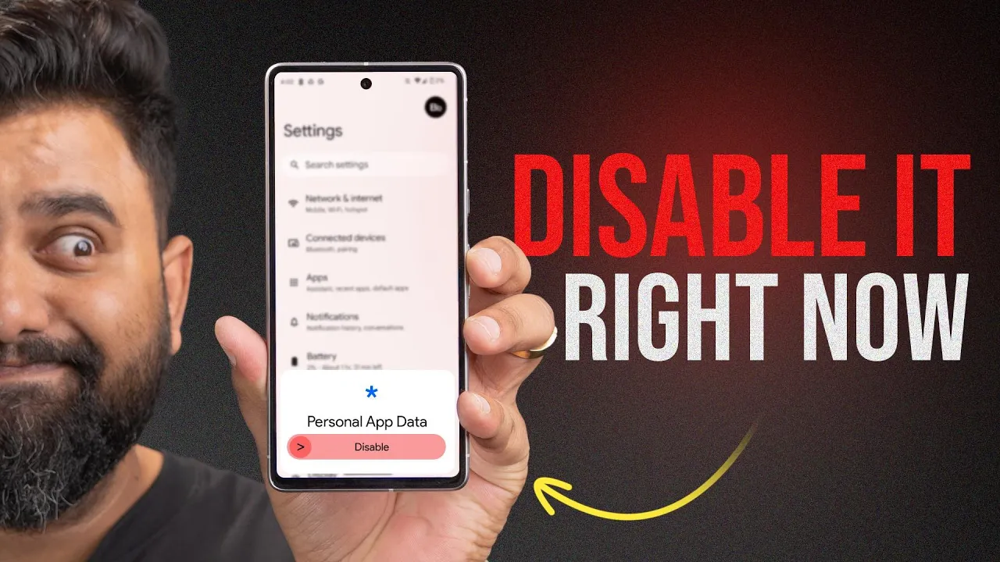

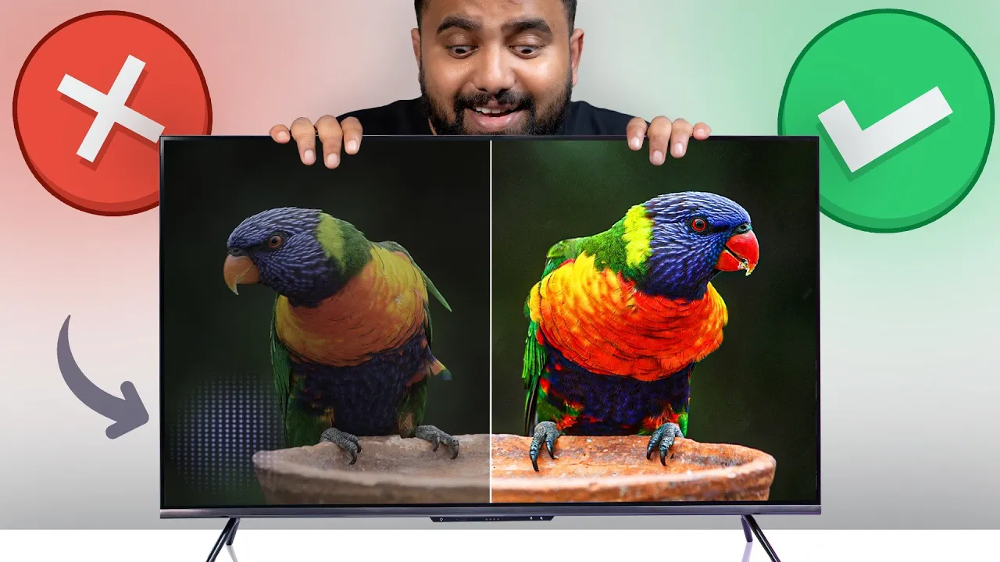

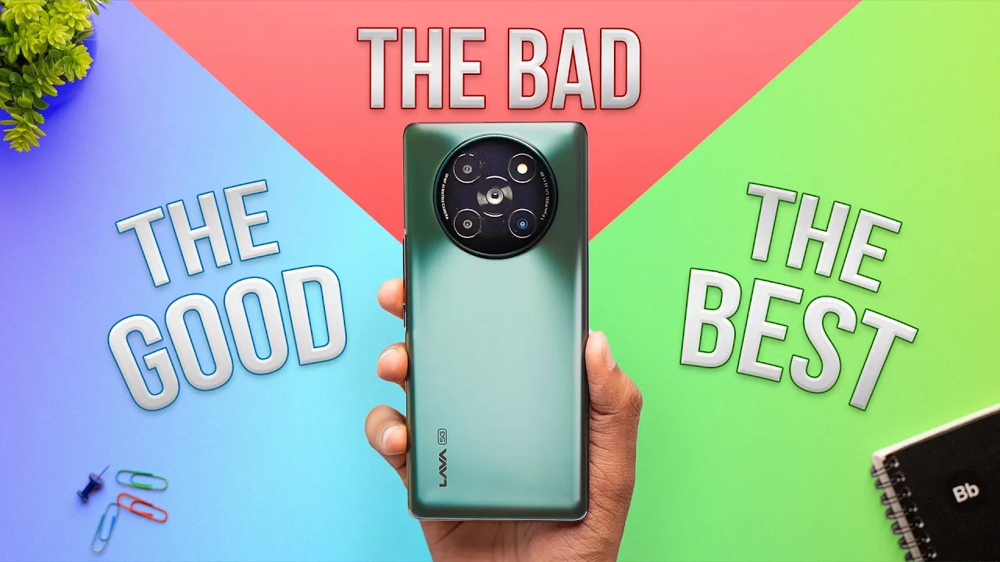

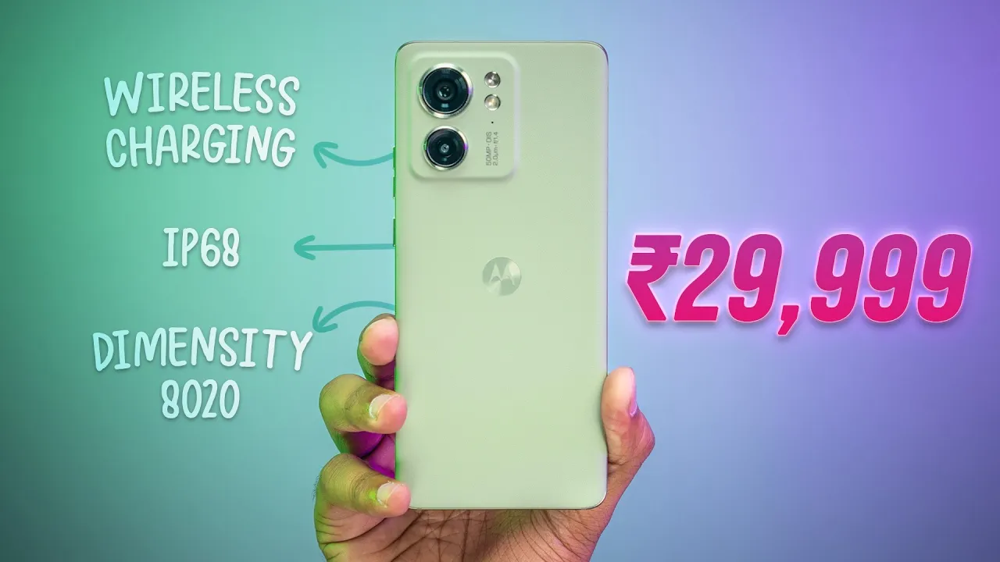

...

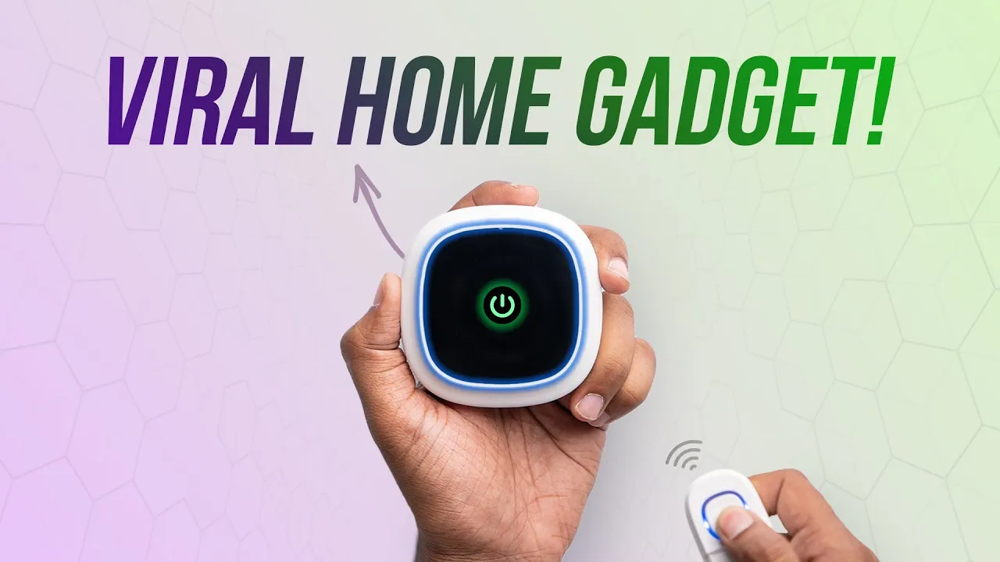

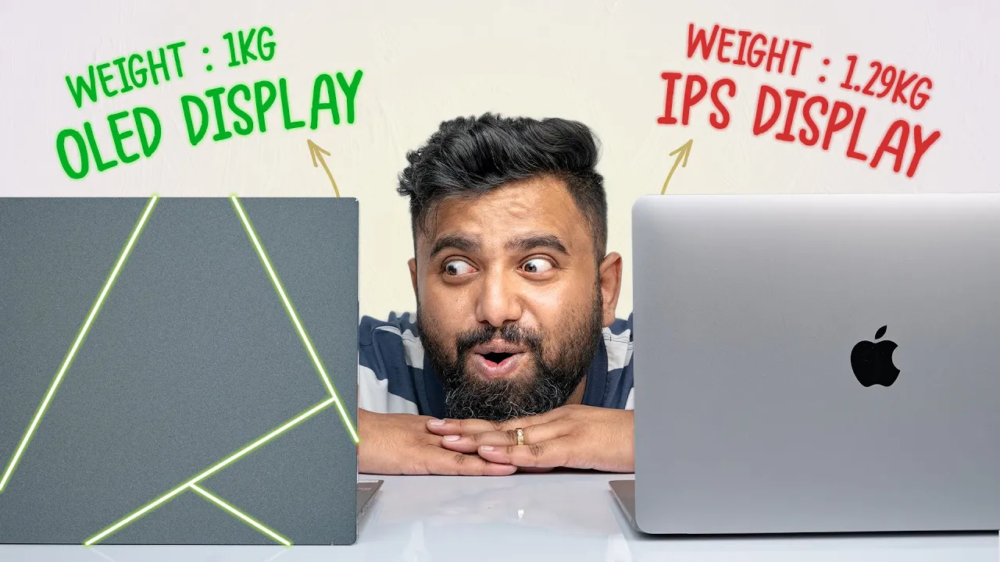

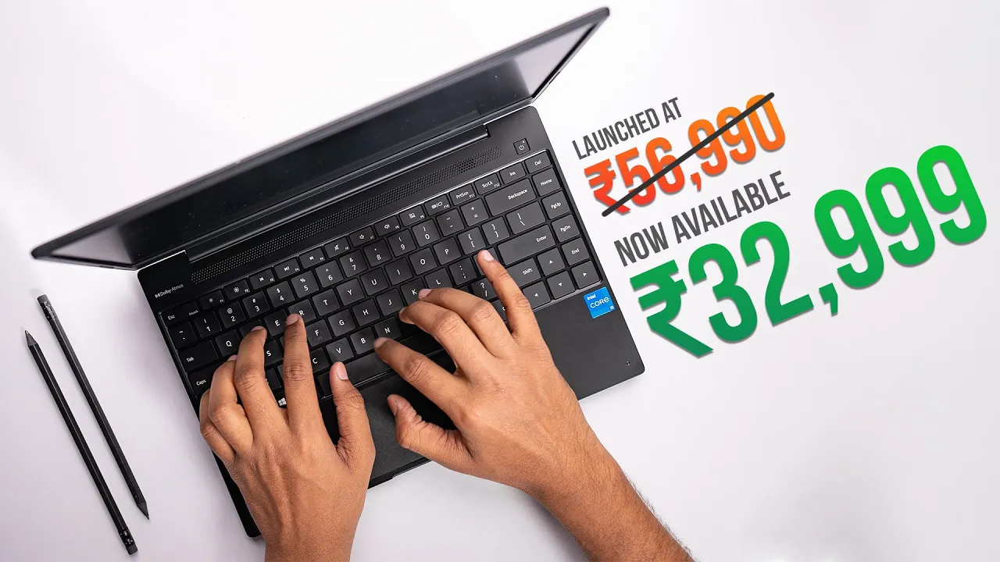

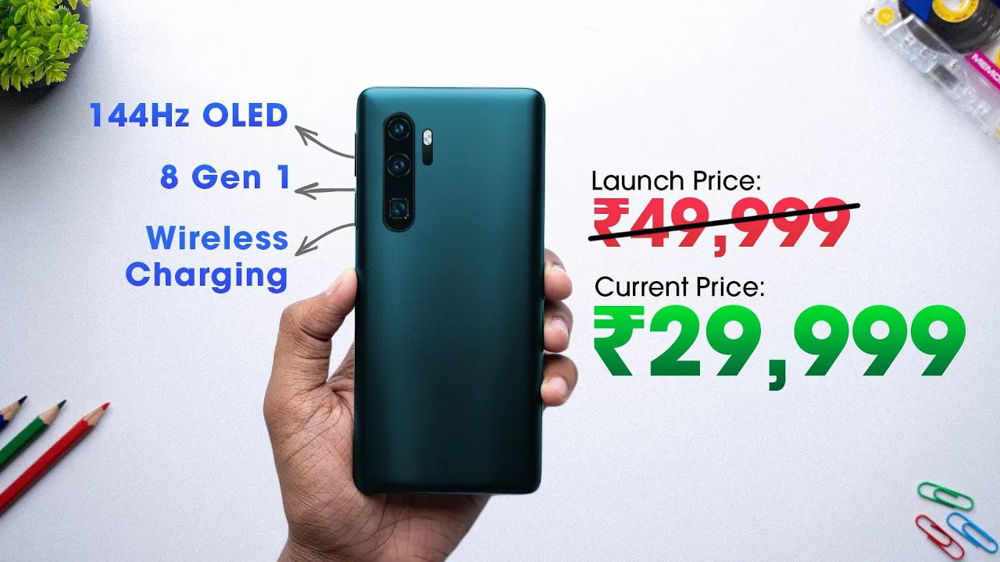

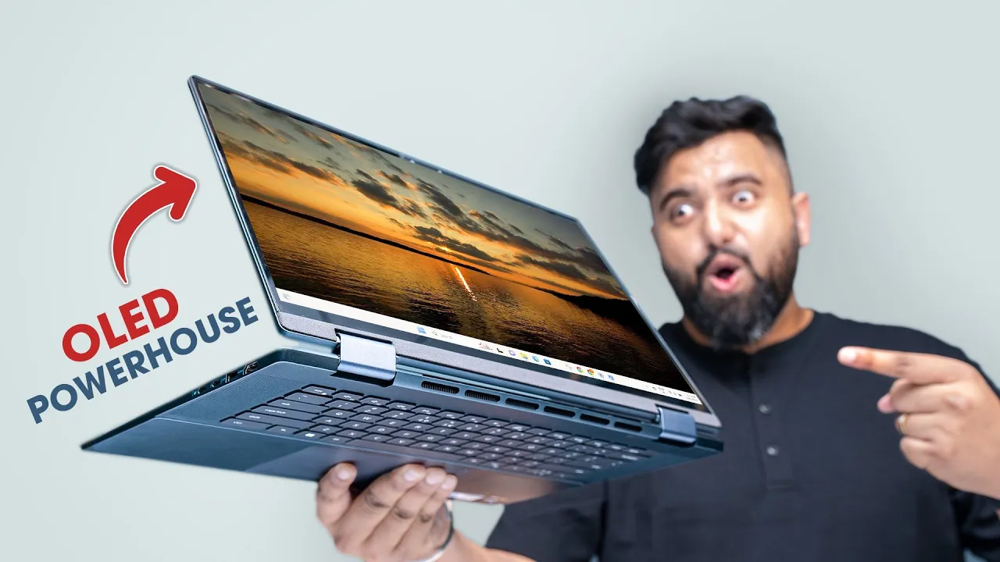

In [7]:
import IPython.display as display
import requests
from PIL import Image
from io import BytesIO
for index, row in data.iterrows():
    response = requests.get(row['thumbnails'])
    img = Image.open(BytesIO(response.content))
    display.display(img)

Description Analysis - Word Cloud

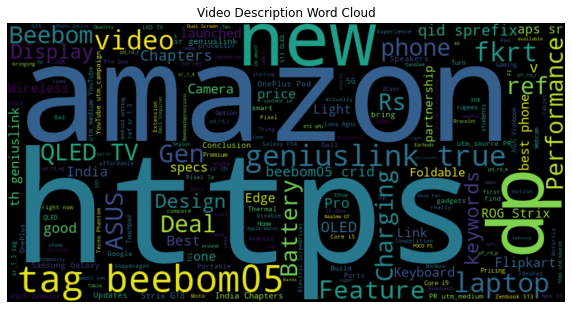

In [8]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
text = ' '.join(data['description'])
wordcloud = WordCloud(width=800, height=400).generate(text)
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Video Description Word Cloud')
plt.show()

In [9]:
import plotly.express as px
top_10_viewed = data.sort_values('view_count', ascending=False).head(10)
fig = px.bar(top_10_viewed, x='title', y='view_count', title='Top 10 Most Viewed Videos')
fig.update_xaxes(title_text='Video Title')
fig.update_yaxes(title_text='View Count')
fig.show()

In [10]:
import plotly.express as px
fig = px.scatter(data, x='duration', y='view_count', size='like_count', color='comment_count',title='Video Duration vs. Engagement')
fig.update_xaxes(title_text='Duration (seconds)')
fig.update_yaxes(title_text='View Count')
fig.show()

In [11]:
import plotly.express as px
fig1 = px.histogram(data, x='like_count', nbins=20, title='Distribution of Likes')
fig1.update_xaxes(title='Likes')
fig1.update_yaxes(title='Count')

fig2 = px.histogram(data, x='comment_count', nbins=20, title='Distribution of Comments')
fig2.update_xaxes(title='Comments')
fig2.update_yaxes(title='Count')

top_likes_videos = data.nlargest(5, 'like_count')
top_comments_videos = data.nlargest(5, 'comment_count')

fig3 = px.bar(top_likes_videos, x='title', y='like_count', title='Top Videos with Highest Likes')
fig3.update_xaxes(title='Video Title')
fig3.update_yaxes(title='Likes')

fig4 = px.bar(top_comments_videos, x='title', y='comment_count', title='Top Videos with Highest Comments')
fig4.update_xaxes(title='Video Title')
fig4.update_yaxes(title='Comments')

fig1.show()
fig2.show()
fig3.show()
fig4.show()


In [12]:
import plotly.graph_objects as go

##Group data by published date and calculate total view count##
view_count_by_date = data.groupby(data['published_at'].dt.date)['view_count'].sum()
##Create line chart for time series analysis##
fig = go.Figure(data=go.Scatter(x=view_count_by_date.index, y=view_count_by_date.values,mode='lines', name='View Count'))
fig.update_layout(title='Time Series Analysis of View Count',xaxis_title='Date', yaxis_title='View Count')
fig.show()

In [19]:
import plotly.express as px

# Creating a scatter plot of view count vs. like count
fig = px.scatter(data, x='view_count', y='like_count', title='View Count vs. Like Count')
fig.show()

# Correlation Analysis
correlation = data[['view_count', 'like_count']].corr().iloc[0, 1]
print("Correlation between view count and like count:", correlation)

Correlation between view count and like count: 0.9716906519218829


In [20]:
fig = px.scatter(data, x='like_count', y='comment_count',title='Likes vs. Comments', trendline='ols')
fig.update_xaxes(title='Likes')
fig.update_yaxes(title='Comments')
fig.show()

In [21]:
fig = px.bar(data, x='title', y='duration', title='Video Duration')
fig.update_xaxes(title='Video Title')
fig.update_yaxes(title='Duration (seconds)')
fig.update_traces(marker_color='blue')
fig.show()

In [22]:
fig = px.sunburst(data, path=['title'], values='like_count',title='Video Categories and Likes')
fig.show()